In [2]:
df = pd.read_parquet('walmart.parquet')
df

,weekly_sales,sid,dept,store,type,size,temperature_stdev,fuel_price_avg,fuel_price_stdev,cpi_avg,cpi_stdev,unemployment_avg,unemployment_stdev,holidayfreq
0,2,290403,16,15,2,123737,23.590000,3.428192,3.335000,0.400944,133.840645,2.702823,8.021333,0.297342
1,4,153158,82,14,1,200898,72.100000,2.589537,3.425667,0.627762,186.932349,4.380638,8.677667,0.049803
2,3,125687,33,41,1,196321,41.933333,4.764245,3.329333,0.530315,195.040395,4.006414,6.820667,0.658669
3,5,169737,91,2,1,202307,52.056667,7.322638,3.091667,0.397062,214.613947,4.828801,7.803000,0.662790
4,1,269444,45,23,2,114533,68.063333,4.250063,3.456333,0.642555,135.681452,2.723300,4.688667,0.591981
5,6,282500,92,41,1,196321,45.673333,4.272731,3.449333,0.602107,193.238010,4.173586,6.948000,0.408180
6,3,321608,97,36,1,39910,48.420000,6.997078,2.921333,0.360078,212.939111,4.888664,8.064333,0.714864
7,5,353243,38,15,2,123737,57.446667,3.420590,3.746000,0.674827,135.039003,2.852534,7.997667,0.294680
8,4,245920,25,35,2,103681,71.326667,6.171340,3.420000,0.619069,139.659489,2.820419,8.794667,0.096469
9,3,100688,33,14,1,200898,73.030000,4.365215,3.415000,0.558470,186.320783,4.420625,8.610333,0.117172


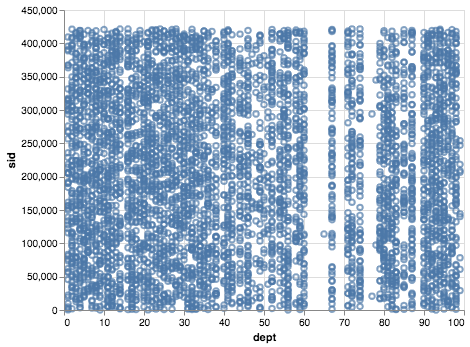

In [13]:
import altair as alt

alt.Chart(df.sample(n=5000)).mark_point().encode(x='dept', y='sid')

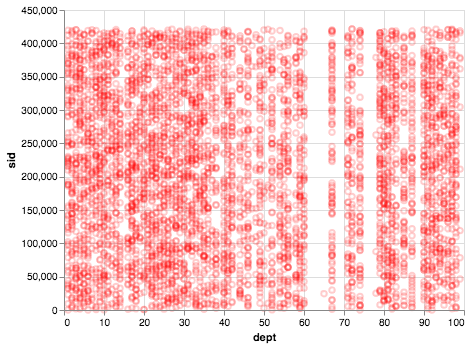

In [6]:
# Customizing Visualizations: https://altair-viz.github.io/user_guide/customization.html#customizing-visualizations
alt.Chart(df.sample(n=5000)).mark_point(opacity=0.2, color='red').encode(x='dept', y='sid')

In [9]:
# alt.Chart(df.sample(n=5000)).configure_mark(opacity=0.2, color='red').encode(x='dept', y='sid')

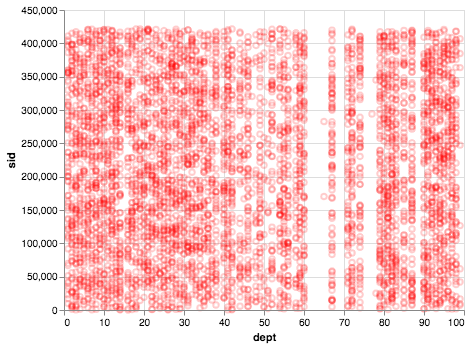

In [10]:
alt.Chart(df.sample(n=5000)).mark_point().encode(x='dept', y='sid', opacity=alt.value(0.2), color=alt.value('red'))

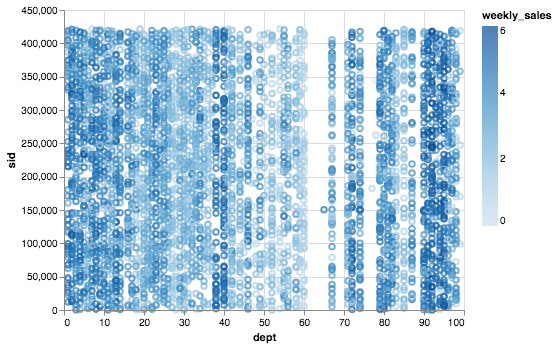

In [14]:
alt.Chart(df.sample(n=5000)).mark_point().encode(x='dept', y='sid', color='weekly_sales')

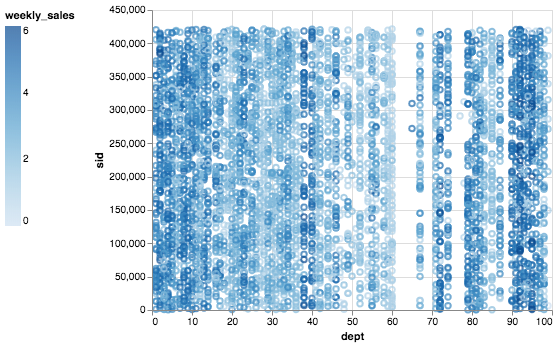

In [21]:
alt.Chart(df.sample(n=5000)).mark_point() \
    .encode(
        x='dept',
        y='sid',
        color=alt.Color('weekly_sales', legend=alt.Legend(orient="left"))
    )

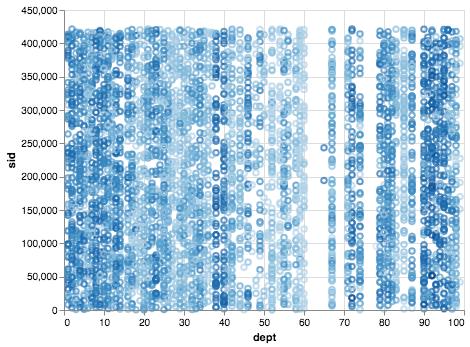

In [22]:
alt.Chart(df.sample(n=5000)).mark_point() \
    .encode(
        x='dept',
        y='sid',
        color=alt.Color('weekly_sales', legend=None)
    )

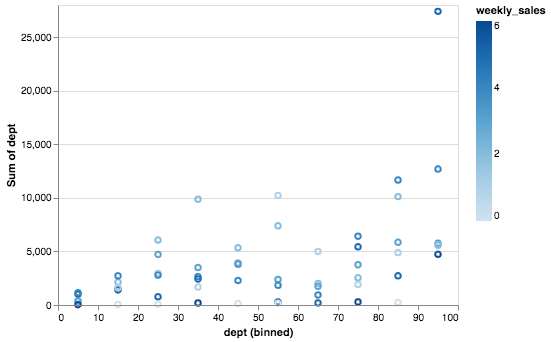

In [43]:
alt.Chart(df.sample(n=5000)).mark_point() \
    .encode(
        x=alt.X('dept', bin=alt.Bin(maxbins=10)),
        y=alt.Y('sum(dept)'),
        color=alt.Color('weekly_sales')
    )

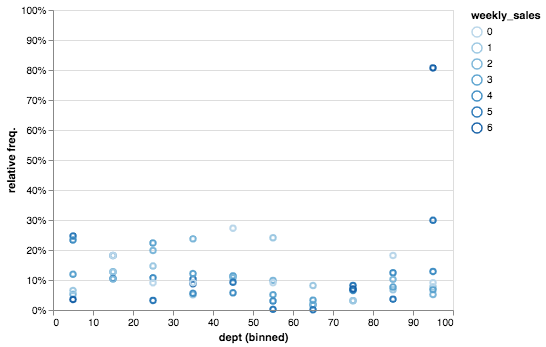

In [59]:
alt.Chart(df.sample(n=5000)).mark_point() \
    .encode(
        x=alt.X('dept:Q', bin=alt.Bin(maxbins=10)),
        y=alt.Y(
            'sum(freq):Q',
            stack=None,
            axis=alt.Axis(format='.0%'), 
            title='relative freq.', 
            scale=alt.Scale(domain=(0.0, 1.0))),
        color=alt.Color('weekly_sales:O')
    ).transform_window(
        total='count(dept)',
        frame=[None, None],
        groupby=['weekly_sales']
    ).transform_calculate(
        freq='1/datum.total'
    )

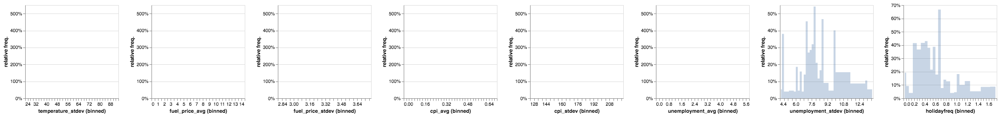

In [62]:
hists = []
chart = alt.Chart(df.sample(n=100)).mark_area(opacity=0.3, interpolate='step')

for col in df.columns:
    hist = chart.copy().encode(
        alt.X(col, bin=alt.Bin(maxbins=50)),
        alt.Y('sum(freq):Q', axis=alt.Axis(format='.0%'), title='relative freq.')
    ).transform_window(
        total='count({})'.format(col),
        frame=[None, None],
        groupby=['weekly_sales']
    ).transform_calculate(
        freq='1/datum.total'
    ).properties(width=200, height=200).interactive()
    
    if df[col].dtype in [int, float]:
        hists.append(hist)
    elif df[col].dtype == 'O':
        hists.append(hist.encode(alt.X(col)))
        
alt.hconcat(*hists)

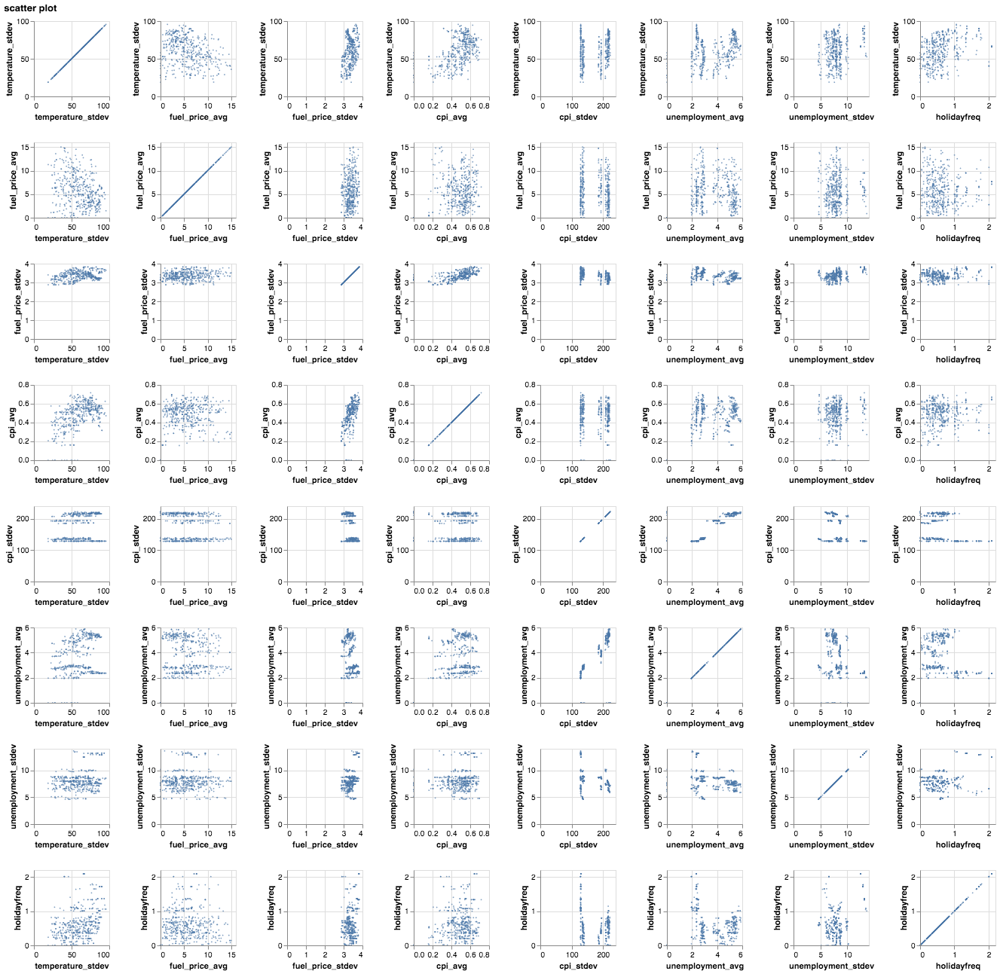

In [8]:
cols = [x for x in df.select_dtypes(include=[int, float]).columns]

alt.Chart(df.sample(n=500)).mark_circle(size=2.5).encode(
    alt.X(alt.repeat('column'), type='quantitative'),
    alt.Y(alt.repeat('row'), type='quantitative')
).properties(width=100, height=100) \
  .repeat(row=cols, column=cols) \
  .properties(title='scatter plot')

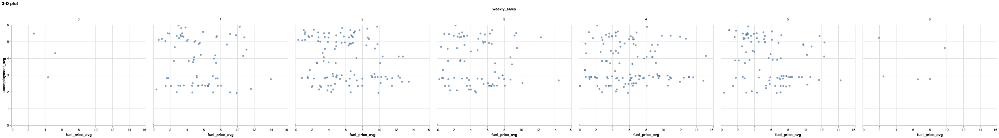

In [54]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x='fuel_price_avg',
    y='unemployment_avg'
  ).facet(column='weekly_sales') \
    .properties(title='3-D plot') \
    .interactive()

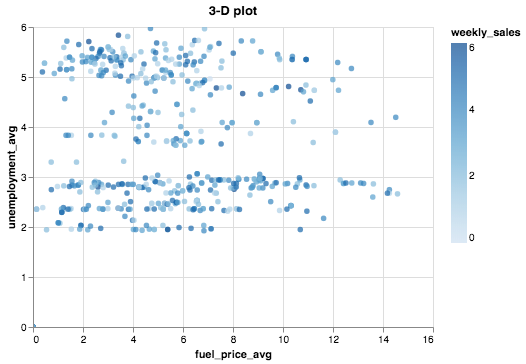

In [24]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x='fuel_price_avg',
    y='unemployment_avg',
    color='weekly_sales'
  ).properties(title='3-D plot') \
    .interactive()

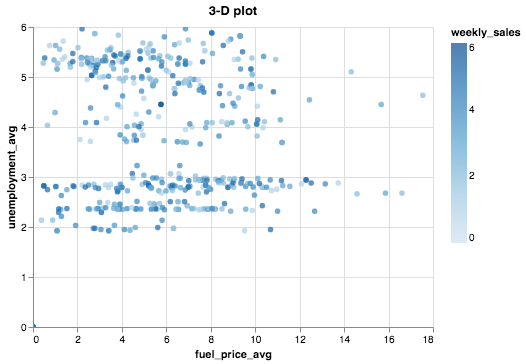

In [26]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x=alt.X('fuel_price_avg', scale=alt.Scale(zero=False)),
    y='unemployment_avg',
    color='weekly_sales'
  ).properties(title='3-D plot') \
    .interactive()

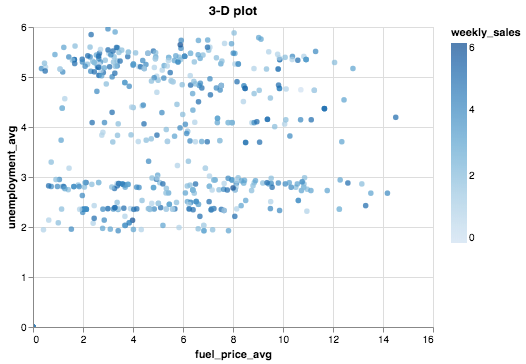

In [27]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x=alt.X('fuel_price_avg', scale=alt.Scale(zero=False)),
    y=alt.Y('unemployment_avg', scale=alt.Scale(zero=False)),
    color='weekly_sales'
  ).properties(title='3-D plot') \
    .interactive()

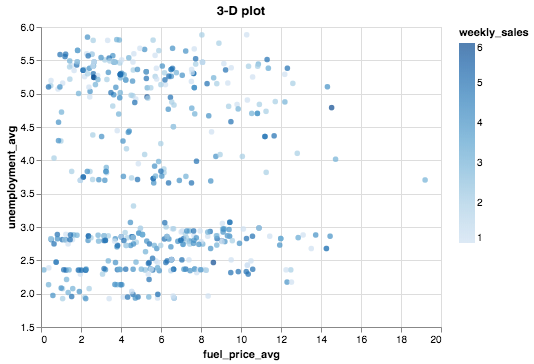

In [30]:
alt.Chart(df.sample(n=500)).mark_circle().encode(
    x=alt.X('fuel_price_avg', scale=alt.Scale(zero=False)),
    y=alt.Y('unemployment_avg', scale=alt.Scale(domain=(1.5, 6.0))),
    color='weekly_sales'
  ).properties(title='3-D plot') \
    .interactive()